In [1]:
import pandas as pd
import numpy as np
from geetools import batch
from tqdm import tqdm
from argparse import ArgumentParser
import matplotlib.pyplot as plt
import rasterio
import requests
from retry import retry


## Creating a Matrix from the Multi Spectral Band Image

In [2]:
dataset = rasterio.open("./sentinel_image_34.72370492925229_135.32032416848173_['B2', 'B3', 'B4', 'B5', 'B6', 'B7', 'B8', 'B8A', 'B11', 'B12'].tif")

In [3]:
image_dtype=dataset.dtypes[0]
image_0=np.zeros((dataset.width,dataset.height,dataset.count),dtype=image_dtype) #creates matrix of width X Height X number of bands
for i in range(dataset.count):
    image_0[:,:,i]=dataset.read(i+1)

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


In [4]:
#matrix with all the bands
image_0.shape

(512, 512, 10)

## Extracting Specific bands for visualization

In [5]:
def vizualize(bands,image_0,value):
    image_bands = image_0[:, :, np.array([bands[0],bands[1],bands[2]])].astype(np.float64)
    max_val = value
    min_val = 0
    # Enforce maximum and minimum values
    image_bands[image_bands[:, :, :] > max_val] = max_val
    image_bands[image_bands[:, :, :] < min_val] = min_val
    for b in range(image_bands.shape[2]):
        image_bands[:, :, b] = image_bands[:, :, b] * 1 / (max_val - min_val)
    return image_bands

In [6]:
band={'B2':0,'B3':1,'B4':2,'B5':3,'B6':4,'B7':5,'B8':6,'B8A':7,'B11':8,'B12':9}
associated_color={'B2':"Blue",'B3':"Green",'B4':"Red",'B5':"VegRedEdge",'B6':"VegRegEdge",'B7':"VegRedEdge",'B8':"NIR",'B8A':"VegRedEdge",'B11':"SWIR",'B12':"SWIR"}
a=['B2','B3','B4','B5','B6','B7','B8','B8A','B11','B12']
#making all band combinations
combination_all=[]
for i in a:
    for j in a:
        for k in a:
            combination_all.append([i,j,k])

In [7]:
#confirms that we are doing 10^3 permution calculations
len(combination_all)

1000

# RGB

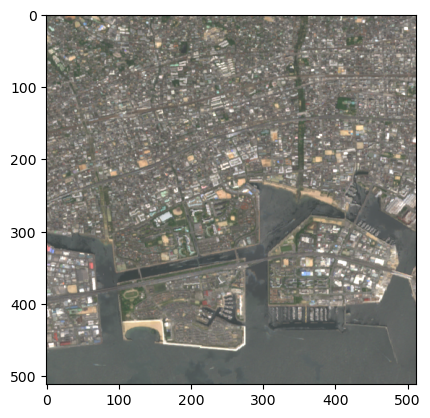

In [8]:
plt.imshow(vizualize([band['B4'],band['B3'],band['B2']],image_0,5000))

# Visualize the first 100 band combinations

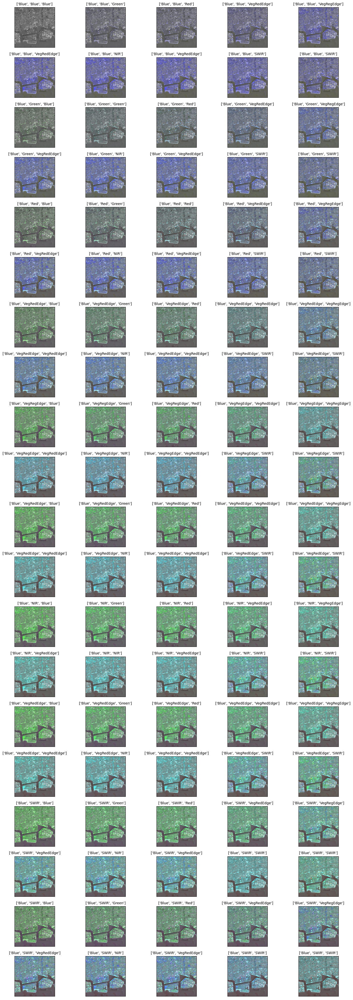

In [9]:
import matplotlib.pyplot as plt
fig, axs = plt.subplots(nrows=20, ncols=5,figsize=(15, 40),
                        subplot_kw={'xticks': [], 'yticks': []})
for ax, combo in zip(axs.flat, combination_all[:100]): #show the first 100 combinations
    array_bands=[band[combo[0]],band[combo[1]],band[combo[2]]]
    ax.imshow(vizualize(array_bands,image_0,5000))
    ax.set_title(str([associated_color[combo[0]],associated_color[combo[1]],associated_color[combo[2]]]),fontsize=10)

plt.tight_layout()
plt.show()

# Visualize the second 100 band combinations

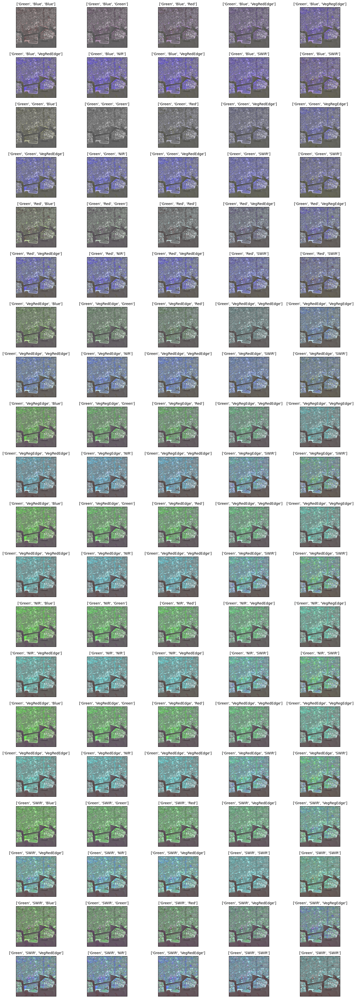

In [10]:
fig, axs = plt.subplots(nrows=20, ncols=5,figsize=(15, 40),
                        subplot_kw={'xticks': [], 'yticks': []})
for ax, combo in zip(axs.flat, combination_all[100:200]): #show the second 100 combinations
    array_bands=[band[combo[0]],band[combo[1]],band[combo[2]]]
    ax.imshow(vizualize(array_bands,image_0,5000))
    ax.set_title(str([associated_color[combo[0]],associated_color[combo[1]],associated_color[combo[2]]]),fontsize=10)

plt.tight_layout()
plt.show()

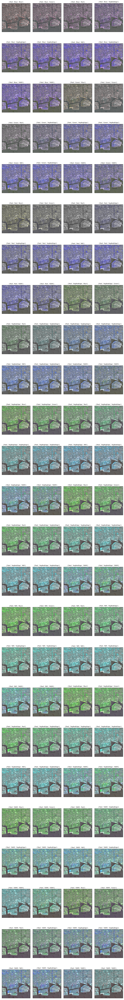

In [11]:
fig, axs = plt.subplots(nrows=25, ncols=4,figsize=(10, 80),
                        subplot_kw={'xticks': [], 'yticks': []})
for ax, combo in zip(axs.flat, combination_all[200:300]): #show the second 100 combinations
    array_bands=[band[combo[0]],band[combo[1]],band[combo[2]]]
    ax.imshow(vizualize(array_bands,image_0,5000))
    ax.set_title(str([associated_color[combo[0]],associated_color[combo[1]],associated_color[combo[2]]]),fontsize=8)

plt.tight_layout()
plt.show()